# Population Simulation

## Initial Idea
The other day I was thinking about a simple population model. Start with $N$ people, then select one of them with uniform probability and give it a child. So now there are $N+1$ people in the population and one of the original $N$ has one offspring. I became interested in the distribution of number of children an individual has after this process is repeated $T$ times. Initially I wanted to run some simulations to get some numbers. The intuitive simulation is to run this as a graph where each person is a node, a new node is introduced at each iteration, and then we can connect it to the node that was selected to have a child. At the end of the $T$ runs, we can just iterate through nodes and then count its edges to get a distribution. But before I implemented it, a better approach came to my mind. Because the number of iterations are known beforehand, we can actually just run this in an array of size $N + T$. Then at each iteration, $i$, we can select an index between 0 to $N + i$ and just increment it by one. Thinking about the problem as an array actually made it much clearer on how to work this out mathematically and save my computer the hard work of running these simulations.


## Players Get Chose
The probability of selecting individual $i$ at time $t$ to have an offspring can be written with the expression below.
$$
P[i, t] = \frac{\mathbf 1_{
i < N + t}}{N + t - 1}
$$

where $\mathbf 1_{S}$ denotes the indicator function of the event $S$ aka a fancy conditional. This is all good, but the probability distribution we are after is the probability of individual $i$ having $k$ kids at time $t$. What we should notice about this is that in order to have $k$ kids at time $t$, you either had $k$ kids already and weren't selected or you had $k-1$ kids and were selected. This allows us to write the distribution recursively. If we let the number of children individual $i$ has at time $t$ be denoted by $X_i^t$, the probability distribution can be written as shown below.

$$
P[X_i^t = k] =  P[X_i^{t-1} = k - 1]P[i, t] + P[X_i^{t-1} = k] \left( 1 - P[i, t]\right)
$$

Notice that, because the population starts at everyone having no offsprings, $P[X_i^0 = 0] = 1$.

## Mathematical Analysis
Although, we could just compute the probability distribution from the recursive formula to study this process, it turns out that some properties of the distribution are somewhat easy to compute. (**Spoiler alert**) Although, these values don't have closed forms, some cool things pop up, and lead to some neat approximations.

Since the first $N$ individuals will have the same properties, we will just analyze the distribution of the first individual, $X^t$. Let $Y_t = X^t - X^{t-1}$ and notice that it is either equal to 1 or 0, because either individual one gets chosen to have a child, or it doesn't. That makes $Y_t$ a Bernoulli distributed variable with probability of 1, $p_t = \frac{1}{N + t - 1}$ with $Y_0 = 0$. With this information in mind, we can get the mean of $X^t$ fairly easily.

### Mean

$$
E\left[ X^t \right] = E\left[ \sum_{i = 1}^t Y_i \right] = \sum_{i = 1}^t p_t = \sum_{i = 1}^t\frac{1}{ N + i - 1}
$$

It's essentially the difference of two partial sums of the [harmonic series](https://en.wikipedia.org/wiki/Harmonic_series_(mathematics)). From a computational perspective that means we can compute the mean in $O(t)$. Were it not for this computation we would have had to do $O((N + t)^2)$ operations to get the probability distribution recursively and then compute the mean for our given time. Furthermore, if we don't mind a small error or are working with large $t$ values, we can get a constant time approximation. To do that, we write the mean as the difference of two partial harmonic series and the fact that $H(x) \approx \log{x} + \gamma$; where $\gamma$ is the [Euler–Mascheroni constant](https://en.wikipedia.org/wiki/Euler%27s_constant) and is approximately 0.57721. So we can efficiently compute the mean with the formula below

$$E\left[ X^t \right] = H(N + t - 1) - H(N - 1) \approx \ln{\left[N + t - 1\right]} + \gamma - \ln{\left[N - 1\right]} - \gamma$$
$$E\left[ X^t \right] \approx \ln{\left[ \frac{N + t - 1}{N - 1} \right]}$$

### Variance
Following a similar analysis as above, we can get that the variance is the following.

$$
Var\left[ X^t \right] = Var\left[ \sum_{i = 1}^t Y_i \right] = \sum_{i = 1}^t Var\left[ Y_i \right] = \sum_{i = 1}^t p_t \left( 1 - p_t \right) = \sum_{i = 1}^t\frac{1}{ N + i - 1} - \sum_{i = 1}^t\frac{1}{(N + i - 1)^2}
$$

Notice that the first term is the same as the mean and the second term looks like the partial sum of the reciprocal of squares. Like for the mean, we can write this as a difference of sum of reciprocal squares.

$$
\sum_{i = 1}^t\frac{1}{(N + i - 1)^2} = \sum_{i = 1}^{N + t - 1}\frac{1}{i^2} - \sum_{i = 1}^{N - 1}\frac{1}{i^2}
$$

Anyone familiar with the [Basel problem](https://en.wikipedia.org/wiki/Basel_problem) knows that for large $N + t$ we can approximate the first term in the right-hand side with $\pi^2 / 6$. Putting all of this together we get the following $O(N)$ approximation for computing the variance.

$$Var\left[ X^t \right] \approx \ln{\left[ \frac{N + t - 1}{N - 1} \right]} + \sum_{i = 1}^{N - 1}\frac{1}{i^2} - \frac{\pi^2}{6}$$

### Distribution

Unfortunately, there isn't really any nice(ish) way to get the distribution. Because the process can be written out as a sum of independent variables I though that maybe the way to go was to use a [probability-generating function](https://en.wikipedia.org/wiki/Probability-generating_function), which doesn't really leave us with anything nice. Best we can do is the equality shown below, which will come down to a bunch of nasty product and chain rules.


$$P\left[X^t = k \right] = \frac{1}{k!} \frac{d^k}{(dz)^k} \left[ \prod_{i=1}^t \left(\frac{z + N + i - 2}{N + i - 1}\right) \right]_{z=0} $$

Interestingly, this distribution that came from my stupid model for population dynamics has a name. It's called the [Poisson-binomial distribution,](https://en.wikipedia.org/wiki/Poisson_binomial_distribution) and hopefully it's used to model more realistic process than the crap I came up with. An upside to this is that the wikipedia page points to a library called [poibin](https://github.com/tsakim/poibin) that implemented some relatively new and [efficient methods](https://www.sciencedirect.com/science/article/abs/pii/S0167947312003568?via%3Dihub) to compute this distribution function.

## Distribution of Some Individuals

### Useful Functions For Simulations

In [1]:
import warnings
warnings.filterwarnings('ignore')

from typing import Dict, Tuple


class ProbabilityDistribution(dict):
    def __init__(self, individual: int, N: int):
        super(ProbabilityDistribution, self).__init__()
        self[0] = 1.0
        self._individual = individual
        self._N = N
        self.t = 0
        self._my_t0 = max(self._individual - self._N, 0)

    def __getitem__(self, item) -> float:
        return self.get(item, 0.0)

    def _update_dist(self, new_dist) -> None:
        for k, p in new_dist.items():
            self[k] = p

    def next_step(self) -> None:
        new_dict = {}
        self.t += 1

        if self.t <= self._my_t0:
            return

        max_kids = self.t - self._my_t0
        for i in range(max_kids + 1):
            p = 1 / (self._N + self.t)
            x = 0.0
            if i > 0:
                x += self[i - 1] * p
            if i < self._N - 1:
                x += self[i] * (1 - p)
            new_dict[i] = x

        self._update_dist(new_dict)


def individuals_to_track(individuals: Tuple, initial_pop: int) -> Dict[int, ProbabilityDistribution]:
    return dict(map(lambda i: (i, ProbabilityDistribution(i, initial_pop)) , individuals))

### Animation

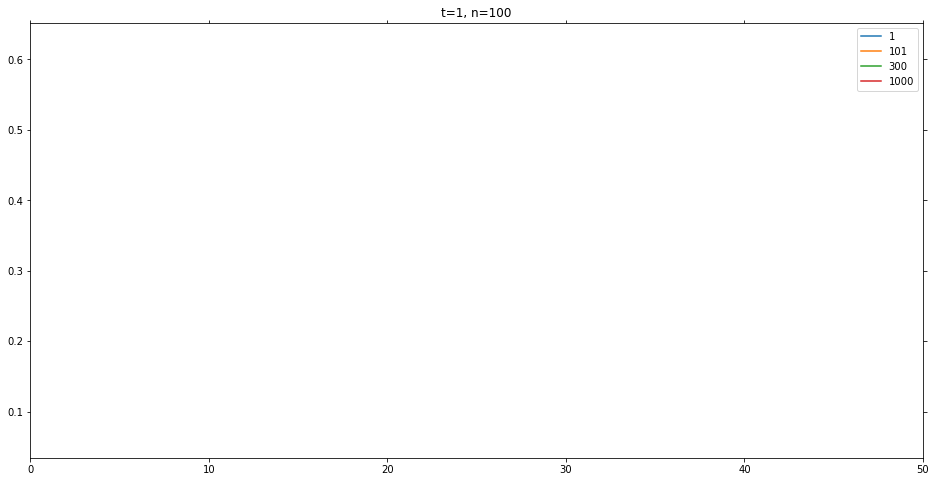

In [11]:
%matplotlib inline
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

from IPython.display import HTML

# Make generator with three individuals
simulation_length = 1500
initial_population_size = 100
individuals_of_interest = (1, 101, 300, 1000)

individuals = individuals_to_track(individuals_of_interest, initial_population_size)

fig = plt.figure(figsize=(16, 8))
ax = fig.add_subplot(autoscale_on=False, xlim=(0, 50), ylim=(0., 1.))
ax.set_title(f"t=0, n={initial_population_size}")
ax.set_xlabel("Kids")
ax.set_ylabel("Probability")
ax.grid()


for i, p in individuals.items():
    x = list(range(1))
    y = [p[k] for k in x]
    ax.plot(x, y, label=i)


def animate(t):
    ax.clear()
    for i, p in individuals.items():
        p.next_step()
        x = list(range(t + 1))
        y = [p[k] for k in x]
        ax.plot(x, y, label=i)
    ax.set_title(f"t={t+1}, n={initial_population_size}")
    ax.set_xlim((0, 50))
    ax.legend()

fps = 10
anim = FuncAnimation(fig, animate, simulation_length + 1, interval=1000/fps, blit=False)
HTML(anim.to_jshtml())

## Appendix: Comparing The Methods and Correctness
That paper is pay-walled, but I can still compare the performance of the library with the recursive formula and a numerical derivative version of the generating function method. One thing about the generating function method that really screws us is that I'm sure numerical stability will be awful taking the 10000th derivative, and I am guessing that one will be the worst performing one.

### Method Comparison
#### Imports

In [3]:
from typing import List
from functools import reduce, partial
from operator import mul
from math import factorial

from scipy.misc import derivative

from poibin import PoiBin

#### Testing Method

To make sure the computations are correct, we will add a test. Note that there are only one way for an individual to have one kid and for an individual to have $t$ kids. Essentially the never got chosen or they every time, respectively. Those computations are very easy to do so we will use them as a check for our computations.

In [4]:
def fact_check(real_p0, real_pt, p0, pt):
    test_result = (abs(real_p0 - p0) < 1e-6, abs(real_pt - pt) < 1e-6)
    return test_result == (True, True)


def endpoints(n: int, t: int) -> Tuple[float, float]:
    p_0 = (n - 1) / (n + t - 1)
    p_t = 1 / reduce(mul, range(n, n + t))
    return p_0, p_t

real_p0, real_pt = endpoints(10, 20)

#### Recursive Method

In [5]:
def recursive_comp(n: int, t: int) -> List[float]:
    last_dist = [0.0] * (t + 1)
    output = [0.0] * (t + 1)

    last_dist[0] = 1.0

    for i in range(t):
        for j in range(i + 2):
            p = 1 / (n + i)
            x = 0.0
            if j > 0:
                x += last_dist[j - 1] * p
            if j < n - 1:
                x += last_dist[j] * (1 - p)
            output[j] = x
        last_dist = output.copy()
    return output

p0, *_, pt = recursive_comp(10, 20)

fact_check(real_p0, real_pt, p0, pt)

True

#### Generating Function

In [6]:
def g(x: float, n: int, t: int) -> float:
    return reduce(
        mul,
        map(
            lambda i: (x + n + i - 2) / (n + i  - 1),
            range(1, t+1)
        )
    )

def generating_method(n: int, t: int) -> List[float]:
    my_g = partial(g, n=n, t=t)
    output = [0] * (t + 1)
    output[0] = my_g(0)
    for i in range(1, t + 1):
        order = max(i + 1 + (i % 2), 3)
        output[i] = derivative(my_g, 0.0, n=i, order=order) / factorial(i)

    return output

p0, *_, pt = generating_method(10, 20)
fact_check(real_p0, real_pt, p0, pt)

True

#### Using [PoiBin](https://github.com/tsakim/poibin)
I've included the main file I needed in to the repo that this notebook belongs to. The reason for that is because I want to compare the performance of computing the probability distribution between these methods, and this library also computes the cumulative distribution function when initializing, so I needed to tweak it.

In [7]:
def poibin_method(n: int, t: int) -> List[float]:
    p_t = [1 / (n + i) for i in range(t)]
    probs = PoiBin(probabilities=p_t)
    return [probs.pmf(k) for k in range(t + 1)]

p0, *_, pt = poibin_method(10, 20)
fact_check(real_p0, real_pt, p0, pt)

True

#### Results

In [8]:
from typing import Callable, Dict
from time import time
from itertools import product

import numpy as np
import pandas as pd


def compare(methods: Dict[str, Callable], ns: List[int], ts: List[int], repeat=3) -> pd.DataFrame:
    assert repeat > 0
    data = []

    for n, t in product(ns, ts):
        real_p0, real_pt = endpoints(n, t)
        for method, func in methods.items():
            data_point = {"method": method, "n": n, "t": t}

            for _ in range(repeat):
                try:
                    start = time()
                    p_0, *mid, p_t = func(n, t)
                    end = time()
                    if not fact_check(real_p0, real_pt, p_0, p_t):
                        print(f"{method=} broke: test failed")
                        data_point["run_time"] = np.NaN
                        data.append(data_point)
                        break
                    data_point["run_time"] = end - start
                    data.append(data_point)
                except Exception as e:
                    print(f"{method=} broke: {e=}")
                    data_point["run_time"] = np.NaN
                    data.append(data_point)
                    break

    return pd.DataFrame(data)

our_methods = {"recursive": recursive_comp, "poibin": poibin_method, "generating_function": generating_method}
n_vals = [10, 100, 1000]
t_vals = [5, 10, 25, 50, 100, 250, 1000]
result_data = compare(our_methods, n_vals, t_vals)

method='generating_function' broke: e=ValueError('array must not contain infs or NaNs')
method='generating_function' broke: e=ValueError('array must not contain infs or NaNs')
method='generating_function' broke: e=ValueError('array must not contain infs or NaNs')
method='generating_function' broke: e=ValueError('array must not contain infs or NaNs')
method='generating_function' broke: e=ValueError('array must not contain infs or NaNs')
method='generating_function' broke: e=ValueError('array must not contain infs or NaNs')


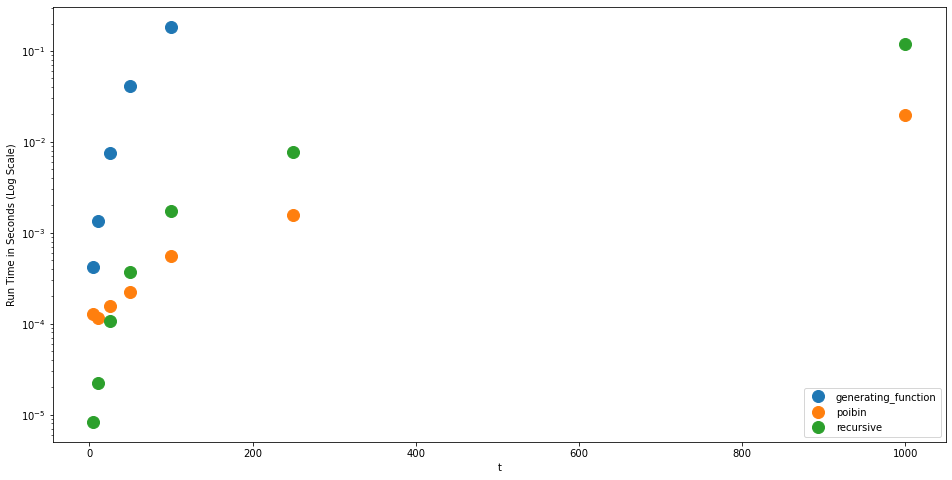

In [9]:
def plot_results(compare_data: pd.DataFrame) -> None:
    tmp = compare_data.groupby(["t", "method"], as_index=False)["run_time"].mean()
    fig, ax = plt.subplots(figsize=(16, 8))
    ax.margins(0.05) # Optional, just adds 5% padding to the autoscaling
    groups = tmp.groupby("method")
    for name, group in groups:
        ax.plot(group.t, group.run_time, marker='o', linestyle='', ms=12, label=name)
    ax.legend()
    ax.set_yscale('log')
    ax.set_xlabel("t")
    ax.set_ylabel("Run Time in Seconds (Log Scale)")
    plt.show()

plot_results(result_data)

The generating function method seems to break some time after it needs to compute its 100th derivative. The recursive method seems to be good for smaller simulation lengths than the PoiBin method, although they both seem to have similar growth curves. Which in this thing could be a bit misleading since that means that their difference in run time is an order of magnitude. The main reason the recursive method was chosen for the animation is that we can keep the last state to compute the next step, unlike PoiBin, which will calculate the "final" result in one go.